## PROCESSAMENTO DE IMAGENS 

**Objetivos da aula:**

*   Conhecer e praticar tracking de objetos em movimento

### Background Subtraction

A intuição de como realizar essa tarefa nós já sabemso, basicamente iremos comparar duas imagem: a de referência do fundo com uma segunda imagem de teste. O resultado irá ressaltar a diferença da imagem. 

### Desafio 1

implemente um codigo simples que faz a subtração das imagens e detecta movimento. 

Dica: você pode usar operações cv2.absdiff(img1, img2) e se necessário realiza uma operação morfologia para reduzir o ruido. o resultado deve ficar parecido com o a imagem "sala_res.png".  

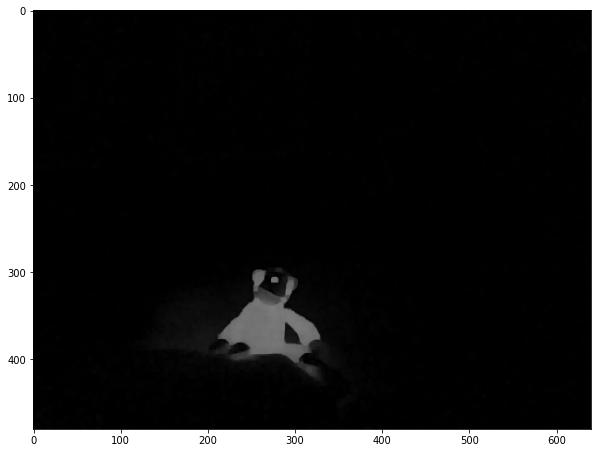

In [38]:
%matplotlib inline
import cv2
from matplotlib import pyplot as plt
import numpy as np

img = cv2.imread('sala_res.png')

plt.figure(figsize = (10,10))
plt.imshow(img); plt.show();


In [ ]:
# Implemente seu código.....

%matplotlib inline
import cv2
from matplotlib import pyplot as plt
import numpy as np

img1 = cv2.imread('sala2.jpg')
img2 = cv2.imread('sala3.jpg')

print("shape ajustado das imagens:",img1.shape, img2.shape)

img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)

# o shape das imagens devem ser iguais
diff = cv2.absdiff(img1, img2)


plt.figure(figsize = (10,10))
plt.imshow(diff,cmap="gray"); plt.show();

dst = diff.copy()
kernel = np.ones((5,5),np.uint8)

opening = cv2.morphologyEx(diff, cv2.MORPH_OPEN, kernel)
plt.figure(figsize = (10,10))
plt.imshow(opening, cmap="Greys_r", vmin=0, vmax=255); plt.show()

#cv2.imwrite('sala_res.png',opening)





### Background Subtraction em videos

Na OpenCV podemos implementar isso por meio de dois algoritmos. O primeiro é ***createBackgroundSubtractorKNN() ou createBackgroundSubtractorMOG2()***. Isso cria um objeto subtrator de fundo por **K-Nearest Neighbor (KNN) ou Mixture of Gaussians (MOG2)** . Então, podemos chamar a função apply() com o objeto para obter a máscara do primeiro plano. Podemos exibir diretamente a máscara de primeiro plano em tempo real (com video :)).

Referência da documentação:
https://docs.opencv.org/master/de/de1/group__video__motion.html#gac9be925771f805b6fdb614ec2292006d

## Executar video no jupyter notebook normalmente da problema.

Existe algumas formas de rodar, ficam com muito delay. 

Sugestão: Escreva um script e execute direto pelo terminal. 

In [40]:
import numpy as np
import cv2

#carrega o video 
cap = cv2.VideoCapture('people-walking.mp4')

# Cria a subtração do fundo
fgbg = cv2.createBackgroundSubtractorMOG2()
fgbg = cv2.createBackgroundSubtractorKNN()

while(1):
    ret, frame = cap.read()
    
    if not ret:
        break
    
    # Aplica a mascara no frame recebido
    fgmask = fgbg.apply(frame)
 
    cv2.imshow('fgmask',frame)
    cv2.imshow('frame',fgmask)

    
    k = cv2.waitKey(30) & 0xff
    if k == 27:
        break
    

cap.release()
cv2.destroyAllWindows()

### Desafio2

Crie um programa python e execute o código acima. O objetivo é se familiarizar com o codigo, alterne entre os metodos MOG2 e KNN e observe os resultados. 

Explore os parametros da função:

    history: O numero de frames usado para construir o modelo estatisco da fundo. Quando menor mais rapido.
   
    dist2Threshold: é o limiar definido para saber se o pixel pertence ao fundo ou não da imagem. Quando menor mais sensivel.
    
    detectShadows : Se True, a sombra (shadows) vai aparecer em cinza na imagem.
    

## DESAFIO 3

Faça um programa que detecta o movimento das pessoas andando na rua e marca com um boundBox (retangulo) o que foi detectado. 

Dicas:

Use 'people-walking.mp4' como video para os testes.

Lembre-se que já estudamos para remover ruido, realçar contorno, detectar bordas....

Leia a documentação https://opencv-python-tutroals.readthedocs.io/en/latest/py_tutorials/py_imgproc/py_contours/py_contour_features/py_contour_features.html e use a função **cv2.boundingRect()** para desenhar o retangulo.

O resultado dever ser semelhante ao do video.


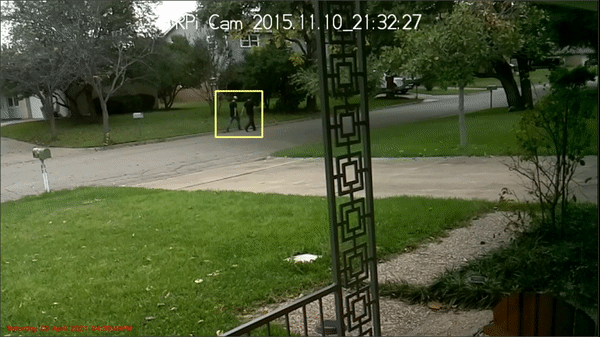

In [45]:
from IPython.display import Image
Image(open('pessoas-gif.gif','rb').read())